# Рынок заведений общественного питания Москвы.
Проектная работа

**Заказчик:** Инвесторы из фонда «Shut Up and Take My Money».  
**Цель:** исследование рынка Москвы, найти интересные особенности, которые в будущем помогут в выборе подходящего инвесторам места: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

<a id='#step0'></a> 
<b> Содержание:</b>
1. [Загрузка данных и изучение общей информации](##step1) 
2. [Предобработка данных](##step2)  
    2.1. [Дубликаты](##step21)  
    2.2. [Выбросы и аномалии в числовых данных.](##step22)  
    2.3. [Пропуски в данных](##step23)  
    2.4. [Дополнительные столбцы.](##step24)
3. [Анализ данных](##step3)  
    3.1. [Категории заведений.](##step31)  
    3.2. [Количество посадочных мест в заведениях по категориям.](##step32)  
    3.3. [Соотношение сетевых и несетевыхю](##step33)  
    3.4. [Сетевые категории заведений.](##step34)  
    3.5. [Топ-15 популярных сетей в Москве.](##step35)  
    3.6. [Административные районы Москвы](##step36)  
    3.7. [Визуализация распределения средних рейтингов по категориям заведений.](##step37)  
    3.8. [Фоновая картограмма (хороплет) со средним рейтингом заведений каждого района.](##step38)  
    3.9. [Все заведения датасета на карте.](##step39)  
    3.10. [Топ-15 улиц по количеству заведений.](##step310)  
    3.11. [Улицы, на которых находится только один объект общепита.](##step311)  
    3.12. [Медианное значение средних цен для каждого района.](##step312)  
    3.13. [Другие взаимосвязи.](##step313)  
    3.14. [Выводы по общему анализу.](##step314)  
4. [Исследование для открытия кофейни.](##step4)  
    4.1. [Количество кофеен по районам.](##step41)  
    4.2. [Круглосуточные кофейни.](##step42)  
    4.3. [Рейтинги кофеен.](##step43)  
    4.4. [Стоимость чашки капучино.](##step44)  
    4.5. [Рекомендации расположения новых кофеен.](##step45)  
5. [Общий вывод.](##step5)
6. [Презентация.](##step6)



!pip install matplotlib --upgrade  
!pip install seaborn --upgrade  
!pip install plotly --upgrade  
!pip install folium --upgrade  
!pip install cufflinks  
print('END')  

In [1]:
import pandas as pd
import numpy as np
#import scipy.stats as st
import json
import re

import matplotlib.pyplot as plt
import seaborn as sns


import plotly.express as px 
from plotly import graph_objects as go
from plotly.offline import iplot
import cufflinks
cufflinks.go_offline()
# Настройка глобальной темы cufflinks
cufflinks.set_config_file(world_readable=True, theme='pearl', offline=True)

# импортируем карту и хороплет
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
# импортируем собственные иконки
from folium.features import CustomIcon
import folium

import warnings # убипрает не критические ошибки
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

D:\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# Сброс ограничений на количество выводимых рядов
pd.set_option('display.max_rows', None)
 
# Сброс ограничений на число столбцов
pd.set_option('display.max_columns', None)
 
# Сброс ограничений на количество символов в записи
pd.set_option('display.max_colwidth', None)

In [3]:
from IPython.core.display import HTML
HTML("""<style>.output_png {display: table-cell;text-align: center;vertical-align: middle;}</style>""")

## Описание данных.
[Содержание](##step0)

Доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

Файл **moscow_places.csv**:
- `name` — название заведения;
- `address` — адрес заведения;
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- `hours` — информация о днях и часах работы;
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
        «Средний счёт: 1000–1500 ₽»;
        «Цена чашки капучино: 130–220 ₽»;
        «Цена бокала пива: 400–600 ₽».
        и так далее;
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
        Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
        Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
        Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
        Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
        Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
        Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым:
        0 — заведение не является сетевым
        1 — заведение является сетевым
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.

<a id='#step1'></a> 
# 1. Загрузка данных и изучение общей информации.
[Содержание](##step0)

In [4]:
try:
    data = pd.read_csv(r'datasets/moscow_places.csv')
except:
    data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')
data.head(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [6]:
old_cnt_row = data.shape[0]
print(f'В данных всего {old_cnt_row} строк')
print(f'Количество уникальных заведений на сырых данных {data.name.nunique()}')
print(f'Количество уникальных типов заведений на сырых данных {data.category.nunique()}')
print(f"Представленные типы заведений: {', '.join(data.category.unique())}.")

В данных всего 8406 строк
Количество уникальных заведений на сырых данных 5614
Количество уникальных типов заведений на сырых данных 8
Представленные типы заведений: кафе, ресторан, кофейня, пиццерия, бар,паб, быстрое питание, булочная, столовая.


<a id='#step2'></a> 
# 2. Предобработка данных.

<a id='#step21'></a> 
## 2.1. Дубликаты.
[Содержание](##step0)

**Явные дубликаты в данных.**

In [7]:
data.duplicated().sum()

0

- **Явных дубликатов не выявлено.**

**Неявные дубликаты** мы можем посмотреть, используя для сравнения несколько столбцов, например, по названию заведения и по адресу.

В данном случае будут показаны почти похожие строки, у которых будет отличие в каком-нибудь одном столбце, например в chain, можно предположить, что это ошибка выгрузки из разных БД и объединить данные заведения.

In [8]:
venues = data.copy()
venues['name'] = venues['name'].str.lower()

In [9]:
df = venues[venues[['name', 'address']].duplicated(keep=False)]
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00–18:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00–00:00",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


In [10]:
# выделение индексов для удаления
ind = [v for i, v in enumerate(df.index) if i%2==1]

del df
del venues

# удаление дубликатов
data = data.query('index not in @ind')

# проверка на неявные дубликаты
venues = data.copy()
venues['name'] = venues['name'].str.lower()
df = venues[venues[['name', 'address']].duplicated(keep=False)]
df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


In [11]:
del df
del venues

In [12]:
data.shape

(8403, 14)

- **Неявные дубликаты отсутствуют.**

<a id='#step22'></a> 
## 2.2. Выбросы и аномалии в числовых данных.
[Содержание](##step0)

Следующие столбцы имеют числовые данные, в которых могут быть аномалии.

- rating 
- middle_avg_bill 
- middle_coffee_cup
- chain
- seats

In [13]:
data.chain.unique()

array([0, 1], dtype=int64)

In [14]:
data.chain = data.chain.astype('str')
data.chain = data.chain.apply(lambda x: 'сетевое' if x == '1' else 'одиночное')

In [15]:
lst=['middle_coffee_cup', 'middle_avg_bill', 'seats','rating']
for i,v in enumerate(lst, start=1):
    fig = go.Figure()
    fig.add_trace(go.Box(x=data[v], name=v))
    title = f'Аномалии для {v}'
    fig.update_layout(title=title,
                          xaxis_title="Значение")
    fig.show()

In [16]:
dict_of_percentile = {}
for i in lst:
    dict_of_percentile[i] = dict_of_percentile.get(i, 0)\
    + np.percentile(data[~data[i].isna()][i], [95,99])
    print(i, dict_of_percentile[i])

middle_coffee_cup [275.  309.9]
middle_avg_bill [2250. 3750.]
seats [307. 625.]
rating [4.8 5. ]


- Отрицательных значений не наблюдается.
- Чашка кофе за 1568 рублей выбивается из общей картины.
- Средний чек в 10, 11, 35 тыс. рублей так же может повлиять на анализ.
- Рейтинг от 1 до 5 - все нормально.
- Количество посадочных мест: от 300 до 1288 бывает вообще?

### 2.2.1. Аномалии для `middle_coffee_cup`.

In [17]:
over_price = data[data['middle_coffee_cup'] > dict_of_percentile['middle_coffee_cup'][1]]
over_price

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1769,Шоколадница,кофейня,"Москва, Бутырская улица, 95",Северный административный округ,пн-чт 07:30–23:00; пт 07:30–00:00; сб круглосуточно; вс 00:00–23:00,55.807331,37.580716,4.1,средние,Цена чашки капучино:300–350 ₽,NaN,325.0,сетевое,61.0
2075,Il Tocco,кофейня,"Москва, Ходынский бульвар, 11А",Северный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–22:00",55.785455,37.530359,4.1,средние,Цена чашки капучино:280–350 ₽,NaN,315.0,одиночное,NaN
2859,Шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,сетевое,48.0
3718,Кафетериус,кофейня,"Москва, Большая Никитская улица, 35",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.757292,37.595033,4.3,средние,Цена чашки капучино:279–378 ₽,NaN,328.0,сетевое,30.0
5503,Coffee FM,кофейня,"Москва, Авиамоторная улица, 10, корп. 1",Юго-Восточный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–19:00",55.754233,37.715491,4.3,NaN,Цена чашки капучино:250–500 ₽,NaN,375.0,одиночное,190.0
5990,Диемм,кофейня,"Москва, 3-я Фрунзенская улица, 1",Центральный административный округ,"ежедневно, 08:30–23:00",55.719000,37.582203,4.3,средние,Цена чашки капучино:250–390 ₽,NaN,320.0,одиночное,30.0


Для кофейни "Шоколадница" подозрительная средняя стоимость чашки кофе - 1568 рублей.  
В `avg_bill`: "Цена чашки капучино:230–2907 ₽" - возможно ошибка.  
Есть все основания предполагать, что это опечатка и должно быть 230-290 рублей, и тогда средняя стоимость чашки кофе: 260 рублей.

In [18]:
data.loc[2859, 'middle_coffee_cup']  = 260
data.shape

(8403, 14)

### 2.2.2. Аномалии для `middle_avg_bill`.

`middle_avg_bill` на ящике с усами показывает 0. Средний чек 0 рублей?

In [19]:
data[data['middle_avg_bill'] == 0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3688,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,сетевое,200.0


Нулевое значение в данном случае не естественно. Продажа не может быть в ноль. Лучше заменить на None.

In [20]:
data.loc[data['middle_avg_bill'] == 0, 'middle_avg_bill'] = data.middle_avg_bill.median()
data.shape

(8403, 14)

In [21]:
data[data['middle_avg_bill'] > dict_of_percentile['middle_avg_bill'][1] ]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
317,Vоdный,ресторан,"Москва, Ленинградское шоссе, 39, стр. 6",Северный административный округ,"ежедневно, 12:00–00:00",55.834978,37.479791,4.7,высокие,Средний счёт:4500–5500 ₽,5000.0,NaN,одиночное,286.0
730,Чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,одиночное,49.0
1125,На мангале,кафе,"Москва, проспект Мира, 119, стр. 503",Северо-Восточный административный округ,"ежедневно, 10:00–21:00",55.830405,37.617687,1.0,высокие,Средний счёт:4000–5000 ₽,4500.0,NaN,одиночное,NaN
1432,Il Barolo,ресторан,"Москва, Ленинградский проспект, 63",Северный административный округ,"ежедневно, 09:30–23:00",55.802775,37.519925,4.2,высокие,Средний счёт:3500–5000 ₽,4250.0,NaN,одиночное,90.0
1765,КрабыКутабы,ресторан,"Москва, Лесная улица, 20, стр. 4",Центральный административный округ,"пн-чт 09:00–00:00; пт,сб 09:00–01:00; вс 09:00–00:00",55.779654,37.591582,4.7,высокие,Средний счёт:4000–5000 ₽,4500.0,NaN,одиночное,180.0
2795,Крошка Картошка,быстрое питание,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"ежедневно, 10:00–22:00",55.811160,37.799823,4.0,высокие,Средний счёт:1000–10000 ₽,5500.0,NaN,сетевое,NaN
3038,Беллини,ресторан,"Москва, Рублёвское шоссе, 28",Западный административный округ,"ежедневно, 12:00–00:00",55.747632,37.425631,4.3,высокие,Средний счёт:5000–5500 ₽,5250.0,NaN,одиночное,150.0
3396,Марио,ресторан,"Москва, улица Климашкина, 17",Центральный административный округ,"ежедневно, 12:00–00:00",55.767792,37.568453,4.5,высокие,Средний счёт:7000 ₽,7000.0,NaN,одиночное,100.0
3462,Uhvat,ресторан,"Москва, Рочдельская улица, 15с41",Центральный административный округ,"ежедневно, 12:00–00:00",55.755983,37.561909,4.7,высокие,Средний счёт:3000–5000 ₽,4000.0,NaN,одиночное,NaN
3476,Маритим,ресторан,"Москва, Малая Грузинская улица, 23, стр. 1",Центральный административный округ,"ежедневно, 11:00–03:00",55.766043,37.571960,4.3,высокие,Средний счёт:от 5000 ₽,5000.0,NaN,одиночное,187.0


Каких-то зацепок по анамалиям в 10 000, 11 000 не выявлено.  Оставляем так как есть.
В аномалии 35 000 есть подозрение на опечатку в заполнении. Средний чек 20000-50000 в ресторане с названием Кафе с режимом работы круглосуточно? Для данного заведения сократим стоимость на 10.


In [22]:
data.loc[7177, 'middle_avg_bill'] = 3500

### 2.2.3. Аномалии для `seats`.

In [23]:
data[data['seats'] > dict_of_percentile['seats'][0] ]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
127,Арарат,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914310,37.538953,4.2,NaN,NaN,NaN,NaN,сетевое,350.0
171,One Price Coffee,кофейня,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909838,37.541526,4.0,NaN,NaN,NaN,NaN,сетевое,350.0
176,Вуди пицца,пиццерия,"Москва, Дмитровское шоссе, 107А, корп. 1",Северный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.878504,37.540110,4.0,средние,Средний счёт:400–600 ₽,500.0,NaN,одиночное,350.0
194,Ленкорань,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914574,37.539103,1.4,NaN,NaN,NaN,NaN,одиночное,350.0
216,Грузинский бульвар,быстрое питание,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909115,37.540112,4.0,NaN,NaN,NaN,NaN,одиночное,350.0
310,VASILCHUKÍ Chaihona №1,ресторан,"Москва, Флотская улица, 3",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–06:00; вс 11:00–02:00",55.850600,37.485400,4.5,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,сетевое,398.0
465,Бота,пиццерия,"Москва, Флотская улица, 5, стр. 3",Северный административный округ,вт-вс 11:00–23:00,55.852192,37.495276,4.2,средние,Средний счёт:250–500 ₽,375.0,NaN,сетевое,398.0
555,Styling Bull Cafe,столовая,"Москва, улица Василия Петушкова, 3, корп. 3, стр. 1",Северо-Западный административный округ,"пн-пт 09:00–20:00; сб,вс 09:00–18:00",55.834649,37.400662,3.9,NaN,NaN,NaN,NaN,одиночное,310.0
639,Восточная кухня,кафе,"Москва, Волоколамское шоссе, 116, стр. 1",Северо-Западный административный округ,NaN,55.829675,37.413157,3.7,NaN,NaN,NaN,NaN,сетевое,320.0
676,Эскалоп,пиццерия,"Москва, Дмитровское шоссе, 48, корп. 1",Северный административный округ,пн-сб 11:00–22:00,55.845090,37.570305,4.3,средние,Средний счёт:300–1000 ₽,650.0,NaN,одиночное,350.0


Встречаются повторяющиеся значения, значения с "0" на конце и дублирующими цифрами.  
В рамках учебного проекта все значения выше 95 перцентеля следует заменить на значения в 10 раз меньше.

In [24]:
data.loc[data['seats'] > dict_of_percentile['seats'][0], 'seats'] = round(data['seats'] / 10)
data.shape

(8403, 14)

<a id='#step23'></a> 
## 2.3. Пропуски в данных.
[Содержание](##step0)

In [25]:
def get_nan(data):
    display((round(data.isna().mean()*100, 2).reset_index()).merge((data.isna().sum()).reset_index(), 
                                               on='index', how='inner', suffixes=('_nan_%','_nan_count'))\
.style.background_gradient('coolwarm'))

In [26]:
get_nan(data)

,index,0_nan_%,0_nan_count
0,name,0.000000,0
1,category,0.000000,0
2,address,0.000000,0
3,district,0.000000,0
4,hours,6.370000,535
5,lat,0.000000,0
6,lng,0.000000,0
7,rating,0.000000,0
8,price,60.550000,5088
9,avg_bill,54.590000,4587


- Большое количество пропусков в столбце с оценкой одной чашки капучино (`middle_coffee_cup`): **93,64%**.
- Так же больше половины пропусков в столбце с оценкой среднего чека (`middle_avg_bill`): **62,56%**.
- Половина пропусков в строке, которая хранит среднюю стоимость заказа в виде диапазона (`avg_bill`): **54,6%**  
Возможно, в `avg_bill` есть недостающие данные для столбцов `middle_coffee_cup` и `middle_avg_bill`.
- Столбец price имеет 60,56% пропусков. Определить категорию по среднему чеку?
- 43% пропусков в посадочных местах - медиана по категории?
- 6,38% пропусков в описании времени работы - круглосуточно?

### 2.3.1. Пропуски в `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`.

Проверка уникальности названий средней цены в столбце `avg_bill`:

In [27]:
lst = []
for i in data.avg_bill.dropna():
    x = re.findall('.+[:]', i)
    if x[0] not in lst:
        lst.append(x[0])
lst

['Средний счёт:', 'Цена чашки капучино:', 'Цена бокала пива:']

Все ли значения из `avg_bill` добавлены в `middle_avg_bill`, где 'Средний счёт:'

In [28]:
data[~data['avg_bill'].isna() & data['avg_bill'].str.contains('Средний счёт:')\
     &  data['middle_avg_bill'].isna()]#.shape[0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Все ли значения из `avg_bill` добавлены в `middle_coffee_cup`, где 'Цена чашки капучино:'

In [29]:
data[~data['avg_bill'].isna() & data['avg_bill'].str.contains('Цена чашки капучино:')\
     &  data['middle_coffee_cup'].isna()].shape[0]

0

Значения из `avg_bill`, где 'Цена чашки капучино:', но отсутствует `middle_avg_bill`

In [30]:
data[~data['avg_bill'].isna() & data['avg_bill'].str.contains('Цена чашки капучино:')\
     &  data['middle_avg_bill'].isna()].shape[0]

535

Значения из `avg_bill`, где 'Цена чашки капучино:', но отсутствует `middle_avg_bill` для кофеен.

In [31]:
df = data.query('category == "кофейня"')
df_coffe = df[~df['avg_bill'].isna() & df['avg_bill'].str.contains('Цена чашки капучино:')\
         &  df['middle_avg_bill'].isna()]
index_coffe = df_coffe.index
df_coffe.shape[0]

521

**535 строк, где есть средняя цена за чашку кофе, но нет данных по среднему чеку.**  
521 из них - кофейни. Можно предположить, что люди в кофейни идут именно за одним кофе по пути / на работу / с работы, поэтому объективно колонку `middle_avg_bill` приравнять к `middle_coffee_cup`, где есть пропуски в `middle_avg_bill`

Значения из `avg_bill`, где 'Цена бокала пива:', но отсутствует `middle_avg_bill`

In [32]:
data[~data['avg_bill'].isna() & data['avg_bill']\
            .str.contains('Цена бокала пива:') &  data['middle_avg_bill'].isna()].shape[0]

132

Значения из `avg_bill`, где 'Цена бокала пива:', но отсутствует `middle_avg_bill` для бар,паб.

In [33]:
df = data.query('category == "бар,паб"')
df_bear = df[~df['avg_bill'].isna() & df['avg_bill'].str.contains('Цена бокала пива:')\
         &  df['middle_avg_bill'].isna()]
index_bear = df_bear.index
df_bear.shape[0]

130

**132 строки, где есть средняя цена за бокал пива, но нет данных по среднему чеку.**  
130 из них - бар,паб. Можно поступить как с чашками кофе.

In [34]:
# Замена Nan в middle_avg_bill на среднию цену бокала пива и чашки кофе
for ind in (df_coffe.index, df_bear.index):
    data.loc[data.index.isin(ind), 'middle_avg_bill'] = data.query('index in @ind')['avg_bill']\
    .apply(lambda x: sum(map(int, re.findall('[0-9]+', x ))))

Остальные пропуски в `middle_avg_bill` и `middle_coffee_cup` в рамках учебного проекта заполнять не будем. 
Так как средний чек, средняя стоимость чашки кофе зависит от:
- типа заведения и его принадлежности к тому или иному виду
- территориальному размещению
- индивидуальным особенностям

Теоретически, можно заполнить медианным значением, но ввиду огромного числа пропусков 90 и 60 % делать такое не стоит. Весь анализ будет на смарку. 

In [35]:
data.avg_bill = data.avg_bill.fillna('unknown')

In [36]:
del df
del df_bear
del df_coffe

### 2.3.2. Пропуски в `seats`.

**для `seats` лучше взять медианные значения по каждой категории, так как в основном определенная категория задедения подразумевает определенное количество посадочных мест**

In [37]:
for typc in data.category.unique():
    med = data.query("category == @typc").seats.median()
    data.loc[data['category'] == typc, 'seats'] = data.query("category == @typc").seats.fillna(med)
    
data.seats = data.seats.astype('int')

### 2.3.3. Пропуски в `price`.

In [38]:
df = data.pivot_table(index='price', values='middle_avg_bill', aggfunc=['median', 'min', 'max'])
df.sort_values(by=('median', 'middle_avg_bill') ,ascending=False)

,median,min,max
,middle_avg_bill,middle_avg_bill,middle_avg_bill
price,,,
высокие,2000.0,350.0,11000.0
выше среднего,1250.0,150.0,4500.0
средние,500.0,60.0,3137.0
низкие,200.0,60.0,600.0


Совсем не понтяно, по какому принципу было разделение на категории.

In [39]:
df = data.middle_avg_bill.describe().reset_index()
df.columns = ['var', 'cost']
df.cost = df.cost.astype('int')
df.T

,0,1,2,3,4,5,6,7
var,count,mean,std,min,25%,50%,75%,max
cost,3800,850,771,30,348,575,1200,11000


In [40]:
a = int(df.loc[df['var']=='25%'].cost)
b = int(df.loc[df['var']=='mean'].cost)
c = int(df.loc[df['var']=='75%'].cost)

data.loc[data['middle_avg_bill'] < a, 'price'] = 'низкие'
data.loc[(data['middle_avg_bill'] >= a) & (data['middle_avg_bill'] < b), 'price'] = 'средние'
data.loc[(data['middle_avg_bill'] >= b) & (data['middle_avg_bill'] < 2*c), 'price'] = 'выше среднего'
data.loc[(data['middle_avg_bill'] >= 2*c) , 'price'] = 'высокие'
data.price = data.price.fillna('unknown')

In [41]:
del df
df = data.pivot_table(index='price', values='middle_avg_bill', aggfunc=['median', 'min', 'max'])
df.sort_values(by=('median', 'middle_avg_bill') ,ascending=False)


,median,min,max
,middle_avg_bill,middle_avg_bill,middle_avg_bill
price,,,
высокие,3000.0,2400.0,11000.0
выше среднего,1250.0,850.0,2300.0
средние,500.0,348.0,825.0
низкие,260.0,30.0,345.0


### 2.3.4. Пропуски в `hours`.

In [42]:
data.hours = data.hours.fillna('unknown')

In [43]:
get_nan(data)

,index,0_nan_%,0_nan_count
0,name,0.000000,0
1,category,0.000000,0
2,address,0.000000,0
3,district,0.000000,0
4,hours,0.000000,0
5,lat,0.000000,0
6,lng,0.000000,0
7,rating,0.000000,0
8,price,0.000000,0
9,avg_bill,0.000000,0


<a id='#step24'></a> 
## 2.4.  Дополнительные столбцы.  
[Содержание](##step0)

Создайте столбец `street` с названиями улиц из столбца с адресом.

In [44]:
#data['street'] = data['address'].apply(lambda x: ''.join(re.findall(' [А-ЯЁ][а-яё]+', x)).strip())
data['street'] = data['address'].apply(lambda x: x.split(', ')[1])

```python
data['address'].str.split(', ').str[1]
```

In [45]:
data.loc[(data['street']== '') | (data['street'].isna()), ['address', 'hours']]

,address,hours


Создайте столбец `is_24/7` с обозначением, что заведение работает ежедневно и круглосуточно. 

In [46]:
data['is_24_7'] = data.hours.str.lower().str.contains('ежедневно, круглосуточно')

**Выводы по разделу предобработка данных**
- **Удалены три неявных дубликата.**
- **Откорректированы аномальные значения.**
- **Заполнены пропуски**:
    - Для `hours` и `avg_bill` были добавлены значения `unknown`.
    - Для `middle_avg_bill` пропуски были заполнены значенияи из `avg_bill` с полями 'Цена чашки капучино', 'Цена бокала пива'. Остальные пропуски были оставлены как есть.
    - Для `middle_coffee_cup` пропуски не заполнялись.
    - Для `seats` - заполнены медианой `seats` для каждой категории заведения.
    - Для `price` - полностью пересмотрены категории заведения (и которые уже были и Nan) на основании `middle_avg_bill`, а так же добавлены значения `unknown`.

<a id='#step3'></a> 
# 3. Анализ данных.


<a id='#step31'></a> 
## 3.1. Какие категории заведений представлены в данных?
[Содержание](##step0)

In [47]:
df = data.groupby('category')['name'].count().sort_values()

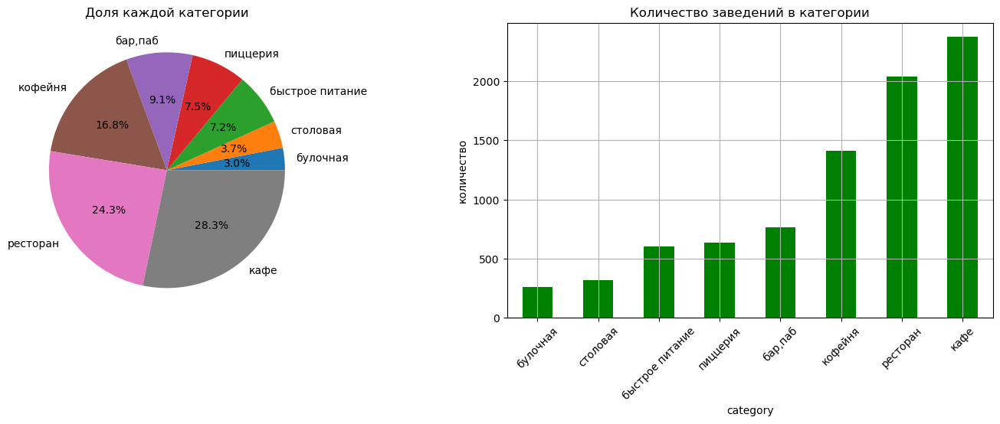

In [48]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(18,5))

df.plot(kind='pie', y='name', legend=False,
               title='Доля каждой категории', autopct='%1.1f%%', ax=ax1, ylabel='');

df.plot(kind='bar', y='name', grid=True, color='green', legend=False, rot=45,
               title='Количество заведений в категории', ax=ax2, ylabel='количество');

- Самый распространенный тип заведения - кафе (28.3%) рынка.
- На втором месте рестораны (24.3%) рынка.
- Кофейни на третьем месте.
- Мало распространены столовые и булочные.

<a id='#step32'></a> 
## 3.2. Количество посадочных мест в заведениях по категориям.

[Содержание](##step0)

,0,1,2,3,4,5,6,7
category,булочная,пиццерия,кафе,быстрое питание,столовая,кофейня,"бар,паб",ресторан
seats_mean,48,50,52,60,63,65,70,80
seats_all,16844,43491,154137,44542,22647,109025,63953,185214


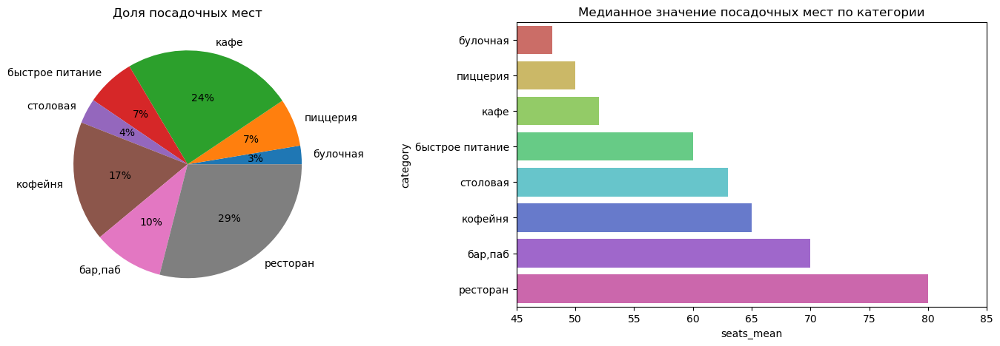

In [49]:
df = data.groupby('category')['seats'].median().sort_values().reset_index().merge(
        data.groupby('category')['seats'].sum().sort_values().reset_index(), on='category')
df.seats_x = df.seats_x.astype('int')
df.columns = ['category', 'seats_mean', 'seats_all']
display(df.T)

fig, (ax1, ax2) = plt.subplots(1,2,figsize=(18,5))

sns.barplot(x=df.seats_mean, y=df.category,  ax=ax2, palette='hls')
plt.xlim(45, 85)
df.plot(kind='pie', y='seats_all', labels=df.category, legend=False, autopct='%.0f%%', ax=ax1, ylabel='', 
        title='Доля посадочных мест')
plt.title('Медианное значение посадочных мест по категории')
plt.show()

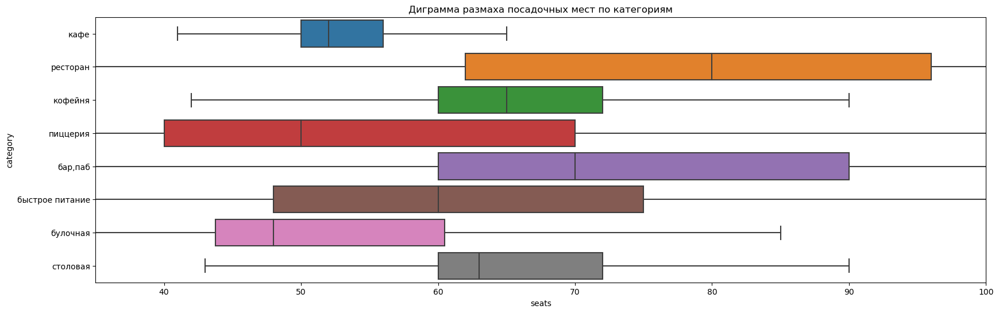

In [50]:
plt.figure(figsize=(20, 6))
sns.boxplot(x='seats', y='category', data=data, showfliers=False) 
plt.title('Диграмма размаха посадочных мест по категориям')
plt.xlim(35, 100)
plt.show()

- Рестораны лидируют как по количеству медианных значений посадочных мест (80), так и по общему - 185214 (29%) на всю Москву.
- В барах и пабах в среднем размещается по 70 человек, но в основной массе всего 63953 (10%) мест на всю Москву.
- по 65 человек размещается в кофейнях, а так как кофейни на 3 месте по распространенности: 109025 (17%) мест на всю Москву.
- В кафе по 52 человек, однако из-за большого количества кафе на всю Москву 154137 (24%) мест


<a id='#step33'></a> 
## 3.3. Каких заведений больше сетевых или несетевых ?
[Содержание](##step0)

In [51]:
# ручная агрегация
# name_rest = ['Сетевой', 'Не сетевой']
# values = [data[data['chain'] == True].name.count(), data[data['chain'] == False].name.count()]
# fig = go.Figure(data=[go.Pie(labels=name_rest, values=values, title='Тип заведения')])
# fig.show() 

In [52]:
def get_pie(data_s, pull_s, pie_title, text_s, height_s=400):
    fig = go.Figure(data=[go.Pie(labels=data_s, pull = pull_s)]) 
    fig.update_layout(title=pie_title, height=height_s,
                  annotations=[dict(x=1.1, y=1.1, text=text_s, showarrow=False)])
    fig.show()

In [53]:
get_pie(data_s=data['chain'], pull_s=[0.1, 0], pie_title='Доля сетевых/одиночных заведений', height_s=400,
       text_s='Тип заведения')

- Сетевых заведений почти в два раза меньше, чем самостоятельных.

<a id='#step34'></a> 
## 3.4. Какие категории заведений чаще являются сетевыми?
[Содержание](##step0)

In [54]:
def get_countplot(data_s, xx, hue_s, plot_title, title_size=20):
    plt.figure(figsize=(20,4))
    sns.countplot(x=xx, hue=hue_s, data=data_s)
    plt.title(plot_title, fontsize=title_size)
    plt.show()

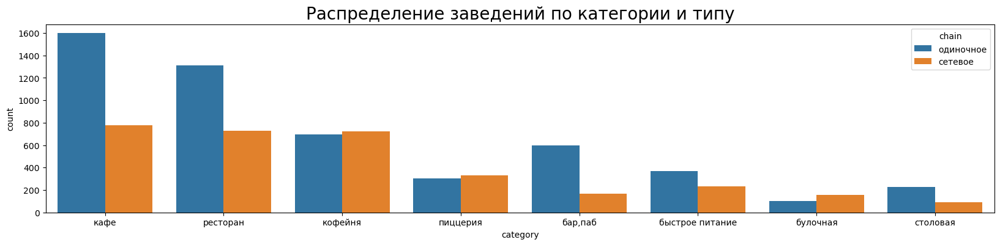

In [55]:
get_countplot(data_s=data, xx='category', hue_s='chain', 
              plot_title='Распределение заведений по категории и типу', title_size=20)

In [56]:
def get_pie_hole(data_s, hole_s, pie_title, text_s, legend_orientation_s='v',  size_title=15, text_size=15):
    fig = go.Figure(data=[go.Pie(labels=data_s, hole=hole_s)])
    fig.update_layout(title=pie_title, font_size=size_title,legend_orientation=legend_orientation_s,
                  annotations=[dict(x=0.5, y=0.5, text=text_s,showarrow=False,font_size=text_size)])
    fig.show() 

In [57]:
get_pie_hole(data_s=data[data['chain']=='сетевое']['category'], hole_s=0.62,
            pie_title='Доля категорий в сетевых заведений', size_title=15,
            legend_orientation_s='h', text_s='Тип<br>сетевого <br> заведения', text_size=20)

- Среди сетевых заведений преобладают кафе - 24.3% от общей доли рынка.
- Так же много сетевых заведений среди ресторанов и кофейн - 22.8% и 22.5% от общего количества соответсвенно.
- Булочные, столовые , пабы и бары - формат душевного заведения, и как следствие, мало такой формат заведений стремится превратится в сеть.
- В самостоятельном сегменте так же преобладают кафе, рестораны, кофейни.

<a id='#step35'></a> 
## 3.5. Топ-15 популярных сетей в Москве. 
[Содержание](##step0)

Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [58]:
df = data[data['chain']=='сетевое'].pivot_table(index=['name', 'category'],values='street',aggfunc='count')\
                                .sort_values(by='street', ascending=False).reset_index()[:15]
fig = px.bar(df, x='street', y='name', text='street', color='category', title='ТОП-15 сетевых заведений по количеству')
fig.update_layout(xaxis_title='Количество заведений в сети',yaxis_title='Наименования заведений')
fig.show()

- В сетевом сегменте распротранены кофейни, пиццерии и рестораны.

<a id='#step36'></a> 
## 3.6. Какие административные районы Москвы присутствуют в датасете?
[Содержание](##step0)

Отобразите общее количество заведений и количество заведений каждой категории по районам. 

In [59]:
# df = data.pivot_table(index=['district', 'category'],values='name',aggfunc='count')\
# .sort_values(by=['category','name']).reset_index()
# fig = px.bar(df, y='district', x='name', color='category', title='Заведения по районам и категорям')
# fig.update_xaxes(tickangle=0)
# fig.update_layout(xaxis_title='Количество заведений',
#                       yaxis_title='Административные районы')
# fig.show()

In [60]:
data['dist'] = data.district.apply(lambda x: x.split()[0])

In [61]:
def get_hist_hue(data, yy, hue, hist_title, x_title, y_title):
    fig = px.histogram(data, y=yy, color=hue, title=hist_title, text_auto=True)
    fig.update_layout(xaxis_title=x_title, yaxis_title=y_title)
    fig.show()

In [62]:
get_hist_hue(data=data, yy='dist', hue="category", hist_title='Распределения заведений по районам и категориям',
             x_title='Количество заведений', y_title='Административные округа')

- Самое большое количество заведений, как общее (~2500), так и по всем категориям, в Центральном округе.
- Южный, Северный, Северо-Восточный, Западный имеют примерно одинаковое распределение заведений.
- Самый мало заселенный Северо-Западный.
- Просматривается четка картина по всем округам: преобладание ресторанов, кафе, и кофейн по округам.
- В центральной части так же стоит обратить внимание на количество баров и пабов.

<a id='#step37'></a> 
## 3.7. Визуализируйте распределение средних рейтингов по категориям заведений. 
[Содержание](##step0)

Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [63]:
# import plotly.graph_objs as go
# from plotly.offline import iplot
# Использование cufflinks в офлайн-режиме
# import cufflinks
# cufflinks.go_offline()
# Настройка глобальной темы cufflinks
#cufflinks.set_config_file(world_readable=True, theme='pearl', offline=True)

def boxplot_hue_plotly(data, column_s, value_s, hist_title, x_title, y_title, legend_s=False):
    data.pivot(columns=column_s, values=value_s).iplot(
        kind='box',
        yTitle=y_title,
        xTitle=x_title,
        legend=legend_s,
        title=hist_title)

In [64]:
boxplot_hue_plotly(data=data, column_s='category', value_s='rating', 
                   hist_title='Диграмма размаха медианных значений рейтинга заведений по категорям', 
                   x_title='Категории заведений', y_title='Рейтинг', legend_s=False)

- Медианные значения рейтинга для всех типов заведений находятся в диапазоне от 4.2 до 4.4.

<a id='#step38'></a> 
## 3.8. Фоновая картограмма (`хороплет`) со средним рейтингом заведений каждого района.
[Содержание](##step0)

In [65]:
# импортируем карту и хороплет
#from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# Для каждого округа посчитаем медианный рейтинг торговых центров, которые находятся на его территории:
rating_df = data.groupby('district', as_index=False)['rating'].agg('median')
display(rating_df.T)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

,0,1,2,3,4,5,6,7,8
district,Восточный административный округ,Западный административный округ,Северный административный округ,Северо-Восточный административный округ,Северо-Западный административный округ,Центральный административный округ,Юго-Восточный административный округ,Юго-Западный административный округ,Южный административный округ
rating,4.3,4.3,4.3,4.2,4.3,4.4,4.2,4.3,4.3


- Высокие оценки ставят посетители заведений, расположенных в Центральном округе.
- Заведения в Северо-Восточном и Юго-Восточном округе меньше всего нравятся посетителям.

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Рад, что получилось визуализировать данные на карте, ведь так быстрее разобраться какая ситуация в каком округе в зависимости от показателя.   
</div>

<a id='#step39'></a> 
## 3.9. Все заведения датасета на карте.
[Содержание](##step0)

In [66]:
# импортируем карту и маркер
# from folium import Map, Marker
# импортируем кластер
# from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
# moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

<a id='#step310'></a> 
## 3.10. Топ-15 улиц по количеству заведений.
[Содержание](##step0)

In [67]:
lst_street = data.groupby('street')['street'].count().sort_values(ascending=False)[:15].index.to_list()
df = data.query("street in @lst_street")[['category', 'street']]

get_hist_hue(data=df, yy='street', hue="category", hist_title='Топ-15 улиц по количеству заведений по категоряим.',
             x_title='Количество заведений на улице', y_title='')

- Лидером по количеству заведений выступает проспект Мира - более 150 штук. Заведения по убыванию популярности: кафе, ресторан, кофейня.
- Популярные улицы: Ленинский проспект, проспект Вернадского, Профсоюзная: 100-120 едален. Рестораны и кафе - ведущие заведения на этих улицах. Кофейни так же восстребованы.
- Слабо популярны такие улицы как Пятницкая, Миклухо-Маклая, Вавилова, Кутузовский проспект.

<a id='#step311'></a> 
## 3.11. Улицы, на которых находится только один объект общепита. 
[Содержание](##step0)

In [68]:
lst_street = data.groupby('street')['name'].count().reset_index().query('name == 1').street.to_list()
df = data.query('street in @lst_street')

### Распределение средних рейтингов по категориям заведений (единственных на своих улицах).

In [69]:
boxplot_hue_plotly(data=df, column_s='category', value_s='rating', 
                hist_title='Диграмма размаха медианных значений рейтинга единственных на своих улицах заведений по категорям', 
                x_title='Категории заведений', y_title='Рейтинг', legend_s=False)

- Медианные значения рейтинга для всех типов заведений (единственных на своих улицах) находятся в диапазоне от 4.2 до 4.5. Отличий от общей картины особо не выявлено.

### Заведения (единственные на своих улицах) по районам и категорям.

In [70]:
get_hist_hue(data=df, yy='dist', hue="category", 
             hist_title='Заведения (единственные на своих улицах) по районам и категорям',
             x_title='Количество заведений', y_title='Административные округа')

Заведения (единственные на своих улицах):
- Самое большое количетсво заведений, как общее (~150), так и по всем категорям, в Центральном округе.
- Южный, Северный, Северо-Восточный, Восточный округа имеют примерно одинаковое распределение заведений.
- Самый мало заселенные Северо-Западный Юго-Западный.
- Просматривается четка картина по всем округам, кроме Центрального: **преобладание кафе**.

### Доля сетевых заведений (единственных на своих улицах).

In [71]:
get_pie(data_s=df['chain'], pull_s=[0.1, 0], pie_title='Доля сетевых заведений (единственных на своих улицах)', height_s=400,
       text_s='Тип заведения')

- Сетевых заведений почти в два раза меньше, чем самостоятельных - так же, как и в общей картинке.

### Какие категории заведений (единственных на своих улицах) чаще являются сетевыми?

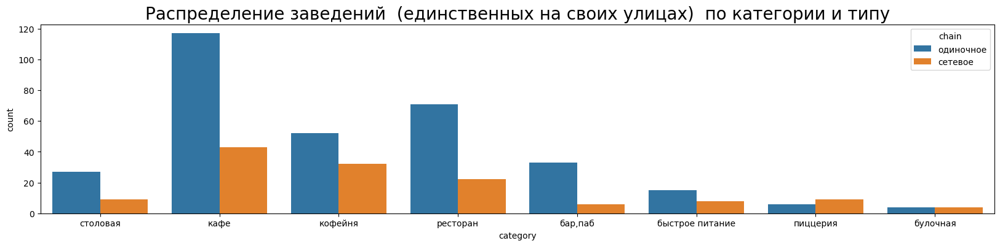

In [72]:
get_countplot(data_s=df, xx='category', hue_s='chain', 
              plot_title='Распределение заведений  (единственных на своих улицах)  по категории и типу', title_size=20)

- Выраженное отличие от общей картины: заведения (единственные на своих улицах) в категории кофейня чаше всего самостоятельные, чем сетевые.
- По остальным категориям отличий от общей картины не наблюдаются. Большая часть единственных на улице заведений - несетевые кафе и рестораны. 

### Распределение средних чеков по категориям заведений (единственных на своих улицах).

In [73]:
boxplot_hue_plotly(data=df, column_s='category', value_s='middle_avg_bill', 
                hist_title='Диграмма размаха средних чеков по категориям заведений (единственных на своих улицах).', 
                x_title='Категории заведений', y_title='Средний чек', legend_s=False)

- Высокие медианные показатели харакерны для пабов, баров, ресторанов - 1000-1275.
- Кафе и пицерии: 500-600.
- Чашка кофе с вкусняйшкой в кофейне обойдется в 370 рублей.
- Дешевле всего покушать в столовой - 275 рублей.

### Распределение средних посадочных мест по категориям заведений (единственных на своих улицах).

In [74]:
boxplot_hue_plotly(data=df, column_s='category', value_s='seats', 
                hist_title='Диграмма размаха средних посадочных мест по категориям заведений (единственных на своих улицах).', 
                x_title='Категории заведений', y_title='Количество посадочных мест', legend_s=False)

(единственных на своих улицах)
- В рестаранах, столовых и пабах по 70-80 мест.
- В кофейнях и кафе по 55-65 мест.
- Менее 50 мест в булочнфх и пицериях.

<a id='#step312'></a> 
## 3.12. Медианное значение средних цен для каждого района. 
[Содержание](##step0)

фоновую картограмму (хороплет) с полученными значениями для каждого района.

In [75]:
boxplot_hue_plotly(data=data, column_s='dist', value_s='middle_avg_bill', 
                hist_title='Диграмма размаха средних чеков по районам.', 
                x_title='Категории заведений', y_title='Средний чек', legend_s=False)

In [76]:
# Для каждого округа посчитаем медианный рейтинг торговых центров, которые находятся на его территории:
df = data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный средний чек по районам',
).add_to(m)

# выводим карту
m

- Самый дорогой средний чек в Центральном округе - 800, с размахом 400-1400.
- Западный округ с большим размахом 380-1250, но с меньшей средней характеристикой - 650.
- Северо-Восточный и Юговостоный округа  имеют наименьшие средние чеки 450 и 400 и более маленький размах.
- Картина в общем повторяет хорплот по рейтингу, за исключением Западного округа. Что там, подают хамон?

<a id='#step313'></a> 
## 3.13. Другие взаимосвязи. 
[Содержание](##step0)

### Медианное значение средних цен по категорям.

In [77]:
boxplot_hue_plotly(data=data, column_s='category', value_s='middle_avg_bill', 
                hist_title='Диграмма размаха средних чеков по категориям заведений.', 
                x_title='Категории заведений', y_title='Средний чек', legend_s=False)

### Часы работы заведений.

#### Доля круглосуточных заведений.

In [78]:
get_pie(data_s=data['is_24_7'], pull_s=[0.5, 0], pie_title='Доля круглосуточных заведений', height_s=400,
       text_s='Тип заведения')

- Только 9 % заведений общественного питания работают круглосуточно.

#### Распределение заведений по часам работы.

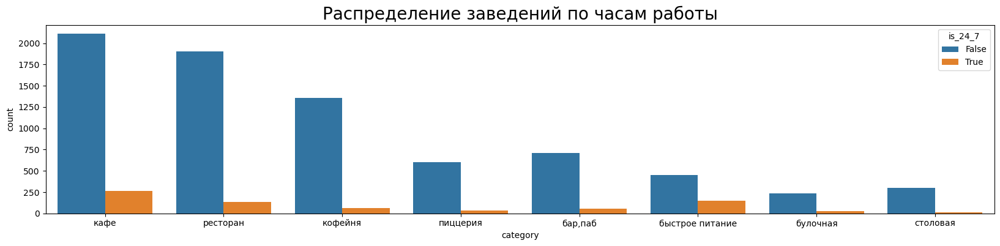

In [79]:
get_countplot(data_s=data, xx='category', hue_s='is_24_7', 
              plot_title='Распределение заведений по часам работы', title_size=20)

- Среди круглосуточных заведений чаще встречаются кафе, заведения быстрого питания и рестораны.

#### Распределение круглосуточных заведений по районам.

In [80]:
# Для каждого округа посчитаем медианный рейтинг торговых центров, которые находятся на его территории:
df = data.query('is_24_7').groupby('district', as_index=False)['name'].agg('count')

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Распределение круглосуточных заведений по районам.',
).add_to(m)

# выводим карту
m

- Больше всего круглосуточных заведений  в Центральном округе. Довольно много их на востоке Москвы. Меньше всего их в Северо-Западном округе.

### Заведения с низкими рейтингами.

In [81]:
fig = go.Figure()
fig.add_trace(go.Box(x=data['rating'], name='rating'))
title = f'Диграмма размаха рейтинга'
fig.update_layout(title=title,
                          xaxis_title="Значение")
fig.show()

Диграмма размаха рейтинга: нижний уровень 3.7.

In [82]:
df = data.query('rating < 3.7')
print(f'Всего {df.shape[0]} заведений с рейтингом ниже 3.7')


Всего 582 заведений с рейтингом ниже 3.7


In [83]:
get_pie_hole(data_s=df['category'], hole_s=0.55,
            pie_title='Доля заведений с низкими рейтингами по категориям', size_title=15,
            text_s='Тип<br> заведения', text_size=30)

- Половина заведений с низкими рейтингами - кафе, по 15 % - рестораны и заведения быстрого питания.

### Распределение среднего чека по категориям заведений с низкими рейтингами.

In [84]:
boxplot_hue_plotly(data=df, column_s='category', value_s='middle_avg_bill', 
                hist_title='Диграмма размаха среднего чека по категориям заведений с низкими рейтингами.', 
                x_title='Категории заведений', y_title='Средний чек', legend_s=False)

- Для заведений с низкими рейтингами самы высокиц медианный средний чек приходится на пицерию - 737 рублей. В рестаранах, кафе и булочных придется потратить 400-500 рублей. Все понятно - рестораны не соостветстуют своей категории. Порхие пабы сравнялись с ресторанами быстрого питания в районе 360 рублей. В кофейнях с таким рейтингом можно покушать дешевле чем в столовой (250-270 рублей).

### Взаимосвязь рейтинга и среднего чека.

Кофф. корреляции 0.19


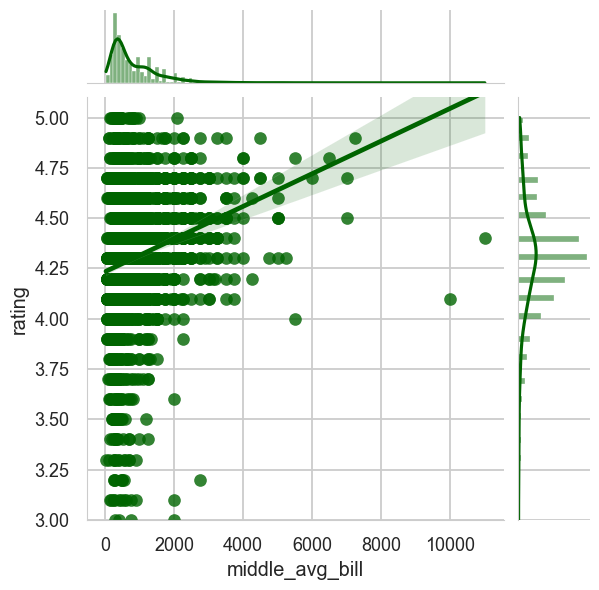

In [85]:
print(f'Кофф. корреляции {data.rating.corr(data.middle_avg_bill):.2f}')
with plt.style.context('seaborn-talk'):
    sns.set_style('whitegrid') 
    sns.jointplot(y='rating', x='middle_avg_bill', data=data, kind='reg',color='#006400')
    plt.ylim(3, 5.1)
    plt.show()

- Рейтинг и средний чек слабо взаимосвязаны.

### Взаимосвязь посадочных мест и среднего чека.

Кофф. корреляции 0.12


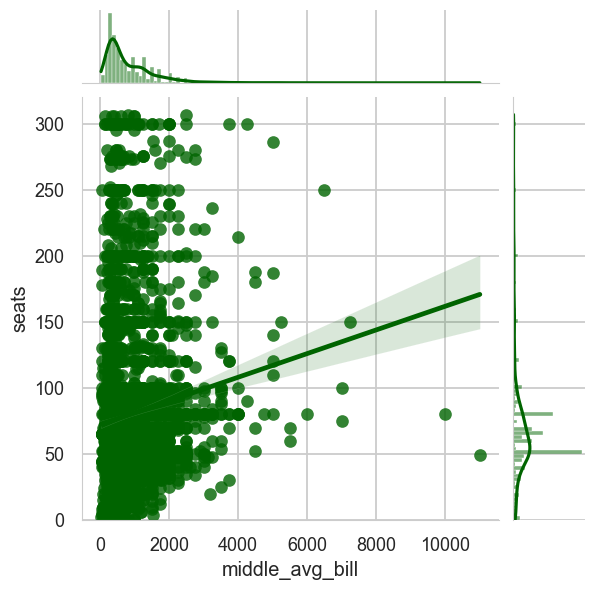

In [86]:
print(f'Кофф. корреляции {data.seats.corr(data.middle_avg_bill):.2f}')
with plt.style.context('seaborn-talk'):
    sns.set_style('whitegrid') 
    sns.jointplot(y='seats', x='middle_avg_bill', data=data, kind='reg',color='#006400')
    plt.ylim(0, 320)
    plt.show()

- Посадочные места и средний чек слабо взаимосвязаны.

<a id='#step314'></a> 
## 3.14. Выводы по общему анализу. 
[Содержание](##step0)

- Самый распространенный тип заведения - **кафе (28.3%) рынка**. На втором месте **рестораны (24.3%) рынка**. **Кофейни на третьем** месте. Мало распространены столовые и булочные.
- **Рестораны** лидируют как по количеству медианных значений **посадочных мест (80)**, так и по общему - 185214 (29%) на всю Москву.В барах и пабах в среднем размещается по 70 человек, но в основной массе всего 63953 (10%) мест на всю Москву. по **65 человек размещается в кофейнях**, а так как кофейни на 3 месте по распространености: 109025 (17%) мест на всю Москву. В **кафе по 52 человек**, однако из-за большого количества кафе на всю Москву 154137 (24%) мест.
- **Сетевых заведений почти в два раза меньше, чем самостоятельных.** Среди сетевых заведений преобладают кафе - 24.3% от общей доли рынка. Так же много сетевых заведений среди ресторанов и кофейн - 22.8% и 22.5% от общего количества соответсвенно.Булочные, столовые , пабы и бары - формат душевного заведения, и как следствие, мало такой формат заведений стремится превратится в сеть.
- В самостоятельном сегменте так же преобладают кафе, рестораны, кофейни.
- Самое большое количетсво заведений, как общее **(~2500)**, так и по всем категорям, **в Центральном округе**. Южный, Северный, Северо-Восточный, Западный имеют примерно одинаковое распределение заведений. **Самый мало заселенный Северо-Западный**.
- Просматривается четка картина по всем округам: **преобладание ресторанов, кафе, и кафейн**.В центральной части так же стоит обратить внимание на количество баров и пабов.
- Медианные значения **рейтинга** для всех типов заведений находятся в диапазоне от **4.2 до 4.4**. Высокие оценки ставят посетители заведений, расположенных в Центральном округе. Заведения в Северо-Восточном и Юго-Восточном округе меньше всего нравятся посетителям.
- Лидером по количеству заведений выступает **проспект Мира** - более 150 штук. Заведения по убыванию популярности: кафе, ресторан, кофейня. Популярные улицы: **Ленинский проспект, проспект Вернадского, Профсоюзная**: 100-120 едален. Рестораны и кафе - ведущие заведения на этих улицах. Кофейни так же восстребованы. Слабо популярны такие улицы как Пятницкая, Миклухо-Маклая, Вавилова, Кутузовский проспект.
- Самый дорогой средний чек в **Центральном округе - 800 рублей**, с размахом 400-1400 рублей. Западный округ с большим размахом 380-1250 рублей, но с меньшей средней характеристикой - 650 рублей. **Северо-Восточный и Юговостоный округа**  имеют наименьшие средние чеки **450 и 400** рублей и более маленький размах. Картина в общем повторяет хорплот по рейтингу, за исключением Западного округа. Что там, подают хамон?
- Только **9 %** заведений общественного питания работают **круглосуточно**. Среди круглосуточных заведений чаще встречаются кафе, заведения быстрого питания и рестораны. Больше всего круглосуточных заведений в Центральном округе. Довольно много их на востоке Москвы. Меньше всего их в Северо-Западном округе.
- **Половина заведений с низкими рейтингами - кафе**, по 15 % - рестораны и заведения быстрого питания.Для заведений с низкими рейтингами самы высокиц медианный средний чек приходится на пицерию - 737 рублей. В рестаранах, кафе и булочных придется потратить 400-500 рублей. Все понятно - рестораны не соостветстуют своей категории. Порхие пабы сравнялись с ресторанами быстрого питания в районе 360 рублей. В кофейнях с таким рейтингом можно покушать дешевле чем в столовой (250-270 рублей).
- Рейтинг и средний чек слабо взаимосвязаны. Посадочные места и средний чек слабо взаимосвязаны.

Заведения, единственные на своих улицах:
- Самое большое количетсво заведений, как общее (~150), так и по всем категорям, в Центральном округе. Южный, Северный, Северо-Восточный, Восточный округа имеют примерно одинаковое распределение заведений. Самый мало заселенные Северо-Западный Юго-Западный.
- Просматривается четка картина по всем округам, кроме Центрального: **преобладание кафе**.
- Медианные значения рейтинга для всех типов заведений (единственных на своих улицах) находятся в диапазоне от 4.2 до 4.5. Отличий от общей картины особо не выявлено.
- В рестаранах, столовых и пабах по 70-80 мест. В кофейнях и кафе по 55-65 мест. Менее 50 мест в булочнфх и пицериях.
- Высокие медианные показатели среднего чека харакерны для пабов, баров, ресторанов - 1000-1275. Кафе и пицерии: средний чек 500-600. Чашка кофе с вкусняйшкой в кофейне обойдется в 370 рублей. Дешевле всего покушать в столовой - 275 рублей.
- Выраженное отличие от общей картины: заведения (единственные на своих улицах) в категории кофейня чаше всего самостоятельные, чем сетевые. По остальным категориям отличий от общей картины не наблюдаются. Большая часть единственных на улице заведений - несетевые кафе и рестораны. Сетевых заведений почти в два раза меньше, чем самостоятельных - так же, как и в общей картинке.

<a id='#step4'></a> 
# 4. Исследование для открытия кофейни. 
[Содержание](##step0)

In [87]:
coffee = data.query('category == "кофейня"')
print('В датасете всего', coffee.shape[0], 'кофеен.')

В датасете всего 1413 кофеен.


<a id='#step41'></a> 
## 4.1. Количество кофеен по районам.
[Содержание](##step0)

### Доля кофеен по округам.

In [88]:
get_pie_hole(data_s=coffee['dist'], hole_s=0.4,
            pie_title='Доля кофеен по округам', size_title=15,
            text_s='Округ', text_size=30)

### Распределение кофеен по округам Москвы на карте.

In [89]:
# Для каждого округа посчитаем медианный рейтинг торговых центров, которые находятся на его территории:
df = coffee.groupby('district', as_index=False)['name'].agg('count')

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Распределение заведений по районам.',
).add_to(m)

# выводим карту
m

- Большая часть кофеен находится в Центральном округе (30 %). От 10 до 14 % кофеен - в Северном, Северо-Восточном и Западном округах. В остальных районах от 4 до 9 % кофеен.

<a id='#step42'></a> 
## 4.2. Круглосуточные кофейни.
[Содержание](##step0)

In [90]:
get_pie(data_s=coffee['is_24_7'], pull_s = [0.1, 0], pie_title='Доля круглосуточных кофейн', height_s=400,
       text_s='Тип заведения')

- 4.2% кофеен работают круглосуточно.

<a id='#step43'></a> 
## 4.3. Рейтинги кофеен.
[Содержание](##step0)

In [91]:
boxplot_hue_plotly(data=coffee, column_s='dist', value_s='rating', 
                hist_title='Диграмма размаха медианных значений рейтинга кофеен', 
                x_title='Категории заведений', y_title='Рейтинг', legend_s=False)

- Медианные рейтинги кофеен не сильно отличаются по районам и составляют примерно 4.3. Наиболшая изменчивость рейтингов кофеен наблюдается в Юго-Западном, в Юго-Восточном и Северном округах. Более стабильная ситуация в Центральном округе.

<a id='#step44'></a> 
## 4.4. Стоимость чашки капучино.
[Содержание](##step0)

In [92]:
boxplot_hue_plotly(data=coffee, column_s='dist', value_s='middle_coffee_cup', 
                hist_title='Диграмма размаха стоимости чашки капучино по районам', 
                x_title='Категории заведений', y_title='Цена', legend_s=False)

- Самый дорогой капучино в кофейнях Юго-Западного округа (198 руб.), на втором и третьем местах - кофейни Центрального и Западного округов (около 190 руб.). Самый дешёвый капучино в кофейнях Восточного округа (135 руб.).

### Взаимосвязь рейтинга и стоимости чашки капучино.

Кофф. корреляции 0.15


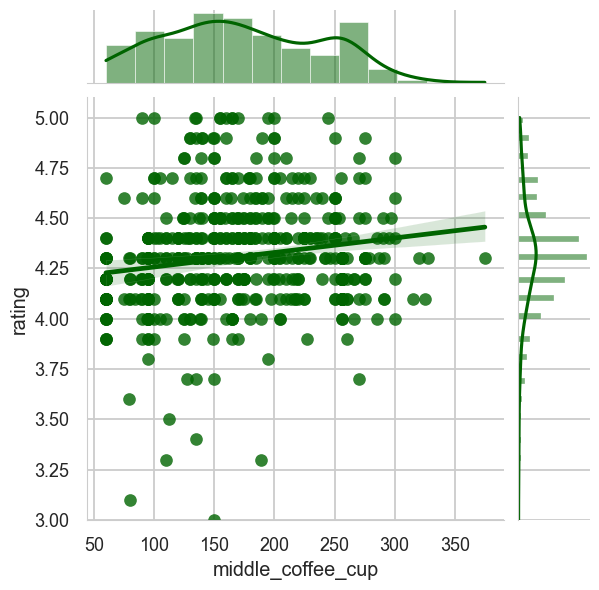

In [93]:
print(f'Кофф. корреляции {data.rating.corr(data.middle_coffee_cup):.2f}')
with plt.style.context('seaborn-talk'):
    sns.set_style('whitegrid') 
    sns.jointplot(y='rating', x='middle_coffee_cup', data=data, kind='reg',color='#006400')
    plt.ylim(3, 5.1)
    plt.show()

- Рейтинг и стоимость чашки капучино слабо взаимосвязаны.

<a id='#step45'></a> 
## 4.5. Рекомендации расположения новых кофеен.
[Содержание](##step0)

**Открыть кофейни в районе с большим количеством кофеен (Центральном округе) и в районе с дефицитом кофеен (Юго-Западном округе). В этих районах и самая высокая стоимость чашки капучино. Если сделать цены более доступными, можно ожидать притока посетителей.**

**В Центральном округе Москвы уже есть большое число кофеен, но и проходимость там больше.**

- **В районе между станциями метро "Цветной бульвар" и "Достоевская" не наблюдается кофеен, зато есть несколько точек притяжения туристов (музеи, театры, цирки).**
-  **Так же не наблюдается кофеен в границах улиц: переулок Сивцев-Вражек, Плотников переулок , Гагаринский переулок, Малый Власьевский переулок. А рядом больницы, музеи, различне центры.**

**В Юго-Западном довольно мало кофеен (около 7 % от общего числа кофеен), но при этом там продаётся самый дорогой кофе (200 руб. за чашку капучино). Возможно, если открыть в этом округе кофейню с более низкими ценами, она будет пользоваться успехом.**
- **На карте Юго-Западного округа есть область в районе пересечения Нахимовского и Севастопольского проспектов, где отсутствуют кофейни. При этом там много жилых домов, учебных заведений и учреждений здравоохранения.**
- **В районе РУДН мало кофеен, а студенты и профессора нуждаются в подзарядке.**

In [94]:
lst = ['Центральный административный округ', 'Юго-Западный административный округ']

# Для каждого округа посчитаем медианный рейтинг торговых центров, которые находятся на его территории:
df = coffee.query("district in @lst").groupby('district', as_index=False)['name'].agg(lambda x: 0)

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='',
).add_to(m)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

# сохраняем координаты предполагаемых мест расположения новой кофейни в переменные
new_coffee_shop_lat_1, new_coffee_shop_lng_1 = 55.776404, 37.618014
new_coffee_shop_lat_2, new_coffee_shop_lng_2 = 55.668533, 37.585377
new_coffee_shop_lat_3, new_coffee_shop_lng_3 = 55.746334, 37.590253
new_coffee_shop_lat_4, new_coffee_shop_lng_4 = 55.649529, 37.505822

# импортируем собственные иконки
# from folium.features import CustomIcon
# import folium

# сохраняем URL-адрес изображения со значком кофейни
icon_url = 'https://imageup.ru/img76/4254587/icons8-coffee-beans-100.png'
# создаём объект с собственной иконкой размером 30x30
icon1 = CustomIcon(icon_url, icon_size=(30, 30))
icon2 = CustomIcon(icon_url, icon_size=(30, 30))
icon3 = CustomIcon(icon_url, icon_size=(30, 30))
icon4 = CustomIcon(icon_url, icon_size=(30, 30))
    
# добавляем маркер на карту
folium.Marker([new_coffee_shop_lat_1, new_coffee_shop_lng_1],\
              popup='Новая кофейня', \
              icon=icon1)\
              .add_to(m)
folium.Marker([new_coffee_shop_lat_2, new_coffee_shop_lng_2],\
              popup='Новая кофейня', \
              icon=icon2)\
              .add_to(m)
folium.Marker([new_coffee_shop_lat_3, new_coffee_shop_lng_3],\
              popup='Новая кофейня', \
              icon=icon3)\
              .add_to(m)
folium.Marker([new_coffee_shop_lat_4, new_coffee_shop_lng_4],\
              popup='Новая кофейня', \
              icon=icon4)\
              .add_to(m)
# выводим карту
m

<a id='#step5'></a> 
## 5. Общий вывод.
[Содержание](##step0)

**В ходе исследования был изучен рынок заведений общественного питания Москвы за 2022г и подготовлены рекомендации для инвесторов по открытию нового объекта общественного питания (кофейни) в Москве.**

1. Всего в исследование вошли 8406 заведений общественного питания Москвы. Из них большую чать составляют кафе (28 %), рестораны (24 %) и кофейни (17 %).
2. Встречаются заведения разного размера, наабольшее количество посадочных мест в среднем от 80 (в ресторанах) до 50 (в булочных).
3. Большая часть заведений общественного питания - несетевые (62 %).
4. Сетевые заведения представлены во всех категориях. Кафе и рестораны в 2 раза чаще бывают несетевыми. Немного чаще сетевыми, чем несетевыми, являются кофейни, пиццерии и булочные.
5. Самая популярная сеть - кофейня "Шоколадница". Затем идут пиццерии "Доминос пицца" и "Додо пицца". Самый популярный ресторан - "Яндекс-Лавка", самое популярное кафе - "Кулинарная лавка братьев Караваевых".
6. Наибольшее количество заведений общественного питания находится в Центральном округе.
7. Рейтинги заведений мало отличаются по категориям и составляют в среднем 4.3.
8. Больше всего заведений общественного питания расположено на проспекте Мира.
9. Заведения, имеющиеся на улице в единственном экземпляре - чаще кафе и рестораны. Чаще всего - это недорогие небольшие заведения с рейтингами выше среднего.
9. Наибольший средний чек (800 руб.) - в Центральном и Западном округах, наименьший - в Юго-восточном округе (400 руб.) В оставльных округах - 500-700 руб.
10. Только около 9 % заведений работают круглосуточно. По большей части это кафе, фаст-фуд и рестораны.
11. 51 % заведений с рейтингами меньше 3.7 - кафе со средними чеками около 400-500руб.
12. В исследование попали 1413 кофеен.
13. Большая часть кофеен находится в Центральном округе.
14. Рейтинги кофеен мало меняются по районам и составляют прмерно 4.3.
15. Самые высокие цены за чашку капучино - в Юго-Западном и Центральном округах (190 руб.), самые низкие - в Восточном округе (135 руб.).
16. Даны рекомендации по возможному размещению новой кофейни - в Центральном или Юго-Западном округе.